In [1]:
from xgboost import XGBRegressor
from sklearn.linear_model import BayesianRidge, Ridge, ElasticNet, LinearRegression

from sklearn.neighbors import KNeighborsRegressor
from sklearn import preprocessing
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, GradientBoostingRegressor

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score,cross_val_predict,train_test_split,GridSearchCV,KFold,StratifiedKFold
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import KNNImputer
import pandas as pd
import numpy as np

In [2]:
def feat_prep():
    #Read the data
    df = pd.read_csv('../gtmsa_practicum_datasets/merged_final_data.csv',dtype=str)
    #convert 2 cols Hospital system if independent and if is critical access hospital to one hot encoding
    df['HS Independent ipps'] = 0
    df['HS Independent cah'] = 0
    idx = df['hospital system or, if independent, ipps/cah'] == 'Independent (IPPS)'
    df.loc[idx,'HS Independent ipps'] = 1
    idx = df['hospital system or, if independent, ipps/cah'] == 'Independent (CAH)'
    df.loc[idx,'HS Independent cah'] = 1
    df['HS critical'] = df['is hospital a critical access hospital (y/n)?'].map({'Y': 1, 'N': 0})
    
    #Dropping cols that seems irrelavant for prediction and also columns with more than 35% of missing values
    cols = ['hospital name','street address','city','state','zip code','hospital system or, if independent, ipps/cah','is hospital a critical access hospital (y/n)?']
    for i in df.columns.values:
        if(np.mean(df[i].isnull())>0.65):
            cols.append(i)
#     cols.remove('relative price for inpatient and outpatient services')
    df.drop(columns=cols,inplace=True)
    #Removing % in column
    
    df['relative price for inpatient facility services'] = df['relative price for inpatient facility services'].str.replace('%','',regex=False)
    df['relative price for outpatient facility services'] = df['relative price for outpatient facility services'].str.replace('%','',regex=False)
 
    #Scaling columns that are scalable using Standard Scaler
    cols_not_scaled = ['medicare provider number','HS critical','HS Independent ipps','HS Independent cah','relative price for inpatient and outpatient services']
    cols_scaled = [x for x in df.columns.values if x not in cols_not_scaled]
    
    np.random.seed(101)
    dt = pd.DataFrame(df[cols_scaled])
    scalers = []
    for i in dt.columns.values:
        dt[i] = pd.to_numeric(dt[i])
        if(i not in cols_not_scaled):
#             from sklearn.preprocessing import QuantileTransformer
            scaler = preprocessing.QuantileTransformer().fit(dt[i].values.reshape(-1, 1))
#             scaler = preprocessing.StandardScaler().fit(dt[i].values.reshape(-1, 1))
            dt[i] = scaler.transform(dt[i].values.reshape(-1,1))
            scalers.append(scaler)
        
    #Imputing missing values using knn imputer
    dt.fillna(np.nan,inplace=True)
    imp = KNNImputer(n_neighbors=8, weights="uniform")
    imp.fit(dt)#IterativeImputer(max_iter=42, random_state=24)
    dt = pd.DataFrame(imp.transform(dt),columns=dt.columns.values)
    cols_knn_imp = dt.columns.values
    #Adding not scaled and not imputed columns to the final dataframe as float
    for i in cols_not_scaled:
        dt[i] = pd.to_numeric(df[i])
        
    #Have medicare provider number as the index for the data instead bein one feature. 
    dt.set_index('medicare provider number',inplace=True)
    return dt, imp, scalers, cols_scaled, cols_knn_imp
data, knn_imputer, scalers, cols_scaled, cols_knn_imp = feat_prep()
print(data.shape)

(3329, 52)


In [3]:
corr =data.corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

In [4]:
import math
idx = abs(corr.iloc[:,-1])>0.01
print(len(corr[idx].index))
print(corr[idx].index)
cols = ['hospital compare 5-star rating (october 2018, na=not available)',
       'number of outpatient services',
       'total private allowed amount for outpatient services ($ millions)',
       'simulated medicare allowed amount for outpatient services ($ millions)',
       'relative price for outpatient services',
       'standardized price per outpatient service',
       'number of inpatient stays',
       'simulated medicare allowed amount for inpatient services ($ millions)',
       'relative price for inpatient services',
       'standardized price per inpatient stay',
       'total private allowed amount for inpatient and outpatient services ($ millions)',
       'simulated medicare allowed amount for inpatient and outpatient services ($ millions)',
       'relative price for professional inpatient and outpatient services',
       'relative price for inpatient facility services',
       'relative price for outpatient facility services',
       'total private allowed amount for facility inpatient and outpatient services ($ millions)',
       'simulated medicare allowed amount for facility inpatient and outpatient services ($ millions)',
       'simulated medicare allowed amount for professional inpatient and outpatient services ($ millions)',
       'Total Discharges.1', 'Average Covered Charges.1','Average Total Payments.1',
       'Average Medicare Payments', 
       'Average Estimated Total Submitted Charges.2',
       'Average Medicare Allowed Amount.2',
       'Average Medicare Payment Amount.2',
       'Outlier Comprehensive APC Services',
       'Outlier Comprehensive APC Services.1',
       'Outlier Comprehensive APC Services.2',
       'Average Medicare Outlier Amount', 'Average Medicare Outlier Amount.1',
       'Average Medicare Outlier Amount.2', 'HS critical',
       'HS Independent ipps', 'HS Independent cah',
       'relative price for inpatient and outpatient services']
data = data[cols]

49
Index(['hospital compare 5-star rating (october 2018, na=not available)',
       'number of outpatient services',
       'total private allowed amount for outpatient services ($ millions)',
       'simulated medicare allowed amount for outpatient services ($ millions)',
       'relative price for outpatient services',
       'standardized price per outpatient service',
       'number of inpatient stays',
       'total private allowed amount for inpatient services ($ millions)',
       'simulated medicare allowed amount for inpatient services ($ millions)',
       'relative price for inpatient services',
       'standardized price per inpatient stay',
       'total private allowed amount for inpatient and outpatient services ($ millions)',
       'simulated medicare allowed amount for inpatient and outpatient services ($ millions)',
       'relative price for professional inpatient and outpatient services',
       'relative price for inpatient facility services',
       'relative pri

In [5]:
# filter to only labeled data
idx = data['relative price for inpatient and outpatient services'].isnull()
dt = data[~idx]
print(dt.shape)
dt.head()

(1628, 35)


,"hospital compare 5-star rating (october 2018, na=not available)",number of outpatient services,total private allowed amount for outpatient services ($ millions),simulated medicare allowed amount for outpatient services ($ millions),relative price for outpatient services,standardized price per outpatient service,number of inpatient stays,simulated medicare allowed amount for inpatient services ($ millions),relative price for inpatient services,standardized price per inpatient stay,...,Outlier Comprehensive APC Services,Outlier Comprehensive APC Services.1,Outlier Comprehensive APC Services.2,Average Medicare Outlier Amount,Average Medicare Outlier Amount.1,Average Medicare Outlier Amount.2,HS critical,HS Independent ipps,HS Independent cah,relative price for inpatient and outpatient services
medicare provider number,,,,,,,,,,,,,,,,,,,,,
10006,0.471471,0.475475,0.263764,0.284785,0.280280,0.105110,0.458959,0.251752,0.674675,0.461141,...,0.000000,0.385021,0.398357,0.000000,0.403900,0.428722,0,0,0,241.0
10029,0.772272,0.754628,0.714715,0.775275,0.147147,0.061974,0.424925,0.332833,0.440440,0.189258,...,0.322072,0.258640,0.467900,0.319548,0.276453,0.474102,0,0,0,174.0
10033,0.197698,0.680681,0.705205,0.685185,0.650150,0.470236,0.482482,0.583584,0.918919,0.947508,...,0.388291,0.438770,0.501363,0.386776,0.426838,0.474036,0,0,0,322.0
10039,0.197698,0.823579,0.786787,0.841341,0.135135,0.068066,0.763764,0.733835,0.864865,0.847639,...,0.124799,0.245680,0.249892,0.120756,0.239575,0.245563,0,0,0,245.0
10056,0.772272,0.453453,0.484484,0.586086,0.138138,0.067234,0.096096,0.090090,0.427427,0.323592,...,0.295093,0.452294,0.427533,0.299030,0.419996,0.421360,0,0,0,174.0


In [6]:
# split dataset to x and y
random_state = 2727
x_data = dt.loc[:, dt.columns != "relative price for inpatient and outpatient services"]
y_data = dt.loc[:, "relative price for inpatient and outpatient services"]

In [7]:
#split dataset
x_train, x_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.3, shuffle=True, random_state=random_state)
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((1139, 34), (489, 34), (1139,), (489,))

In [8]:
import warnings
warnings.filterwarnings('ignore')

model_factory = [
 RandomForestRegressor(),
 LinearRegression(),
 Ridge(),
 BayesianRidge(),
 ExtraTreesRegressor(),
 ElasticNet(),
 KNeighborsRegressor(),
 GradientBoostingRegressor()
]

for model in model_factory:
    model.seed = 222
    num_folds = 5

    y_pred = cross_val_predict(model, x_train, y_train, cv=num_folds)
    score_description = " %0.2f (+/- %0.2f)" % (np.sqrt(mean_squared_error(y_train, y_pred)), y_pred.std() * 2)
    
    print('{model:25} CV-5 RMSE: {score}'.format(
     model=model.__class__.__name__,
     score=score_description
     ))
    

RandomForestRegressor     CV-5 RMSE:  20.42 (+/- 140.87)
LinearRegression          CV-5 RMSE:  26.25 (+/- 144.26)
Ridge                     CV-5 RMSE:  27.19 (+/- 141.29)
BayesianRidge             CV-5 RMSE:  26.45 (+/- 143.43)
ExtraTreesRegressor       CV-5 RMSE:  19.83 (+/- 142.84)
ElasticNet                CV-5 RMSE:  53.88 (+/- 53.06)
KNeighborsRegressor       CV-5 RMSE:  39.65 (+/- 118.45)
GradientBoostingRegressor CV-5 RMSE:  17.84 (+/- 143.50)


In [9]:
def gsFit(clf,param_grid,X,Y,cv,verbose=False,fit_params=None,scoring=None,n_jobs=-1):
    gs = GridSearchCV(clf,param_grid,cv=cv,n_jobs=n_jobs,scoring=scoring,pre_dispatch=8)
    if fit_params is not None:
        gs.fit(X,Y,**fit_params)
    else:
        gs.fit(X,Y)

    if verbose:
        print("Best classifier:")
        print(gs.best_params_)
#         print(gs.cv_results_)

    return gs.best_estimator_

In [10]:
from sklearn import metrics
def print_stats(pred,actuals):
    print('RMSE : ',np.sqrt(metrics.mean_squared_error(actuals, pred)))
    print('MSE : ',metrics.mean_squared_error(actuals, pred))
    print('MAE : ',metrics.mean_absolute_error(actuals, pred))
    print('R2 score : ',metrics.r2_score(actuals, pred))
    print('Variance explained : ',metrics.explained_variance_score(actuals, pred))
    return

<h1> Gradient Boost Regressor

In [11]:
clf = GradientBoostingRegressor(random_state=1010)
param_grid = dict(loss = ['ls', 'lad', 'huber', 'quantile'],learning_rate = np.linspace(0.01,10,8), max_features=['auto', 'sqrt', 'log2'], criterion=['friedman_mse', 'mse', 'mae'])
cv = KFold(n_splits=8,shuffle=True)
GBR_model = gsFit(clf,param_grid,x_train,y_train,cv,verbose=True,fit_params=None,scoring='r2',n_jobs=100)
y_pred_on_train = cross_val_predict(GBR_model, x_train, y_train, cv=8)
y_pred_on_test = GBR_model.predict(x_test)
print('Gradient Boost  Regressor')
print('---------Training----------')
print_stats(y_pred_on_train,y_train)
y_pred_on_test = GBR_model.predict(x_test)
print('----------Testing----------')
print_stats(y_pred_on_test,y_test)

Best classifier:
{'criterion': 'friedman_mse', 'learning_rate': 1.4371428571428573, 'loss': 'huber', 'max_features': 'auto'}
Gradient Boost  Regressor
---------Training----------
RMSE :  37.029576955530565
MSE :  1371.1895695055605
MAE :  25.09669397010855
R2 score :  0.7635775738369122
Variance explained :  0.7637158401206794
----------Testing----------
RMSE :  33.06587961947624
MSE :  1093.3523950096942
MAE :  24.85898281309517
R2 score :  0.8284087479183614
Variance explained :  0.8290053995637874


<h1> Random Forest Regressor

In [12]:
clf = RandomForestRegressor(random_state=102)
param_grid = dict(max_features=['auto', 'sqrt', 'log2'],oob_score=[True,False], criterion=['mse', 'mae'])
cv = KFold(n_splits=8,shuffle=True)
RF_model = gsFit(clf,param_grid,x_train,y_train,cv,verbose=True,fit_params=None,scoring='r2',n_jobs=100)
y_pred_on_train = cross_val_predict(RF_model, x_train, y_train, cv=8)
print('Random Forest Regressor')
print('---------Training----------')
print_stats(y_pred_on_train,y_train)
y_pred_on_test = RF_model.predict(x_test)
print('----------Testing----------')
print_stats(y_pred_on_test,y_test)

Best classifier:
{'criterion': 'mse', 'max_features': 'auto', 'oob_score': True}
Random Forest Regressor
---------Training----------
RMSE :  19.53993592296488
MSE :  381.80909587357337
MAE :  10.708920105355574
R2 score :  0.9341679408995831
Variance explained :  0.9341789386199486
----------Testing----------
RMSE :  19.37765920533537
MSE :  375.4936762781186
MAE :  11.096625766871165
R2 score :  0.9410698413838215
Variance explained :  0.9411436511595527


<h1> Extra Trees Regressor

In [13]:
clf = ExtraTreesRegressor(random_state=102)
param_grid = dict(max_features=['auto', 'sqrt', 'log2'], criterion=['mse', 'mae'],oob_score=[True,False],bootstrap=[True,False])
cv = KFold(n_splits=8,shuffle=True)
extratrees_model = gsFit(clf,param_grid,x_train,y_train,cv,verbose=True,fit_params=None,scoring='r2',n_jobs=100)
y_pred_on_train = cross_val_predict(extratrees_model, x_train, y_train, cv=8)
print('Extra Trees Regressor')
print('---------Training----------')
print_stats(y_pred_on_train,y_train)
y_pred_on_test = extratrees_model.predict(x_test)
print('----------Testing----------')
print_stats(y_pred_on_test,y_test)

Best classifier:
{'bootstrap': False, 'criterion': 'mse', 'max_features': 'auto', 'oob_score': False}
Extra Trees Regressor
---------Training----------
RMSE :  19.364800570657888
MSE :  374.9955011413521
MAE :  10.270008779631256
R2 score :  0.9353427504469345
Variance explained :  0.9354032410473542
----------Testing----------
RMSE :  18.077378954285678
MSE :  326.7916298568507
MAE :  10.381758691206544
R2 score :  0.948713164033048
Variance explained :  0.9489708872190205


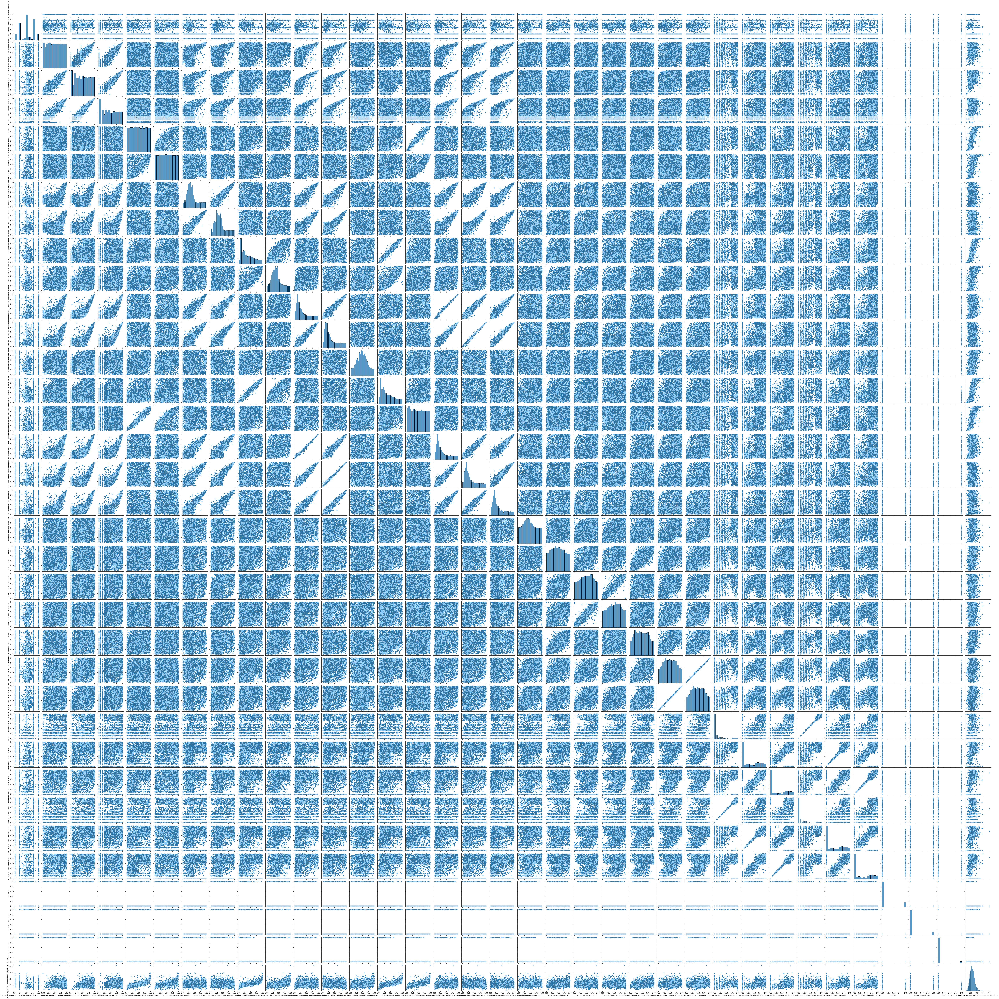

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.pairplot(data)
plt.savefig('Corr_pairplot.png')
plt.show()

In [15]:
import pickle
with open('extratrees_regressor.pk','wb') as file:
    pickle.dump((extratrees_model,knn_imputer,scalers, cols_scaled, cols_knn_imp),file)

<h1> Used Power Transformer but resulted in not so good results

In [8]:
from sklearn.preprocessing import PowerTransformer
cols_to_be_scaled = ['Average Covered Charges.2',
       'Average Total Payments.1', 'Average Medicare Payments',
       'Average Estimated Total Submitted Charges.2',
       'Average Medicare Allowed Amount.2',
       'Average Medicare Payment Amount.2',
       'Outlier Comprehensive APC Services.1',
       'Average Medicare Outlier Amount.1',
       'Average Medicare Outlier Amount.2']
scaler = PowerTransformer(method='yeo-johnson')
data[cols_to_be_scaled] = scaler.fit_transform(data[cols_to_be_scaled])
data

,relative price for outpatient services,standardized price per outpatient service,relative price for outpatient facility services,Total Discharges.1,Average Covered Charges.2,Average Total Payments.1,Average Medicare Payments,Average Estimated Total Submitted Charges.2,Average Medicare Allowed Amount.2,Average Medicare Payment Amount.2,Outlier Comprehensive APC Services.1,Average Medicare Outlier Amount.1,Average Medicare Outlier Amount.2,"hospital compare 5-star rating (october 2018, na=not available)",HS_critical,HS_Independent_ipps,HS_Independent_cah,relative price for inpatient and outpatient services
medicare provider number,,,,,,,,,,,,,,,,,,
10001,-1.136727,-1.396079,-1.375121,0.441402,0.134672,-0.317632,-0.165588,0.049442,0.194786,0.224887,-0.489957,-0.056559,0.747343,-0.975916,0,0,0,NaN
10005,-0.405128,-0.667021,-0.441686,0.159356,-1.448754,-1.373863,-1.199539,-0.836426,-0.535786,-0.541155,-0.089105,0.274557,1.577448,-1.896341,0,0,0,NaN
10006,-0.576353,-0.975247,-0.682338,0.253896,-0.157024,-0.341222,-0.263126,0.745559,0.771186,0.764940,-0.548942,-0.291257,-0.493860,-0.055490,0,0,0,241.0
10011,-0.778711,-1.118472,-1.098008,-0.058186,0.216611,-0.005239,-0.063061,0.448842,-0.210777,-0.187944,-0.598531,-0.697680,1.041395,-0.975916,0,0,0,NaN
10012,-1.198991,-1.381318,-1.389706,-0.614412,0.198706,-1.429537,-1.956129,0.193893,-0.326607,-0.308254,-0.010640,-0.144321,0.931221,-0.975916,0,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
670083,1.462784,0.341691,0.953807,-0.371322,1.144486,0.677145,0.332704,3.570533,-1.560509,-1.536076,1.505780,1.967304,1.947202,0.680850,0,1,0,NaN
670087,2.108771,0.735340,1.941489,-0.491833,0.091536,-0.611251,-0.528311,-0.539319,-1.431588,-1.410294,-0.146410,-0.339470,-0.414714,-0.239575,0,1,0,NaN
670090,0.949108,0.011982,0.513626,-0.575308,2.786852,-0.915549,-0.395942,-0.333550,-1.560624,-1.529675,0.446487,0.943914,-0.954827,0.864935,0,1,0,NaN
